In [2]:
# Load GEOPANDAS library
import geopandas as gpd
import pandas as pd
import os, sqlite3
import math
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import plotly.express as px
from pygments.lexers import go


In [3]:
#Script for translating Swiss coordinates LV03 to Global coordinates WGS84
#Sources: Swisstopo, https://github.com/ValentinMinder/Swisstopo-WGS84-LV03/tree/master

class GPSConverter(object):
    '''
    GPS Converter class which is able to perform convertions between the 
    CH1903 and WGS84 system.
    '''
    # Convert CH y/x/h to WGS height
    def CHtoWGSheight(self, y, x, h):
        # Axiliary values (% Bern)
        y_aux = (y - 600000) / 1000000
        x_aux = (x - 200000) / 1000000
        h = (h + 49.55) - (12.60 * y_aux) - (22.64 * x_aux)
        return h

    # Convert CH y/x to WGS lat
    def CHtoWGSlat(self, y, x):
        # Axiliary values (% Bern)
        y_aux = (y - 600000) / 1000000
        x_aux = (x - 200000) / 1000000
        lat = (16.9023892 + (3.238272 * x_aux)) + \
              - (0.270978 * pow(y_aux, 2)) + \
              - (0.002528 * pow(x_aux, 2)) + \
              - (0.0447 * pow(y_aux, 2) * x_aux) + \
              - (0.0140 * pow(x_aux, 3))
        # Unit 10000" to 1" and convert seconds to degrees (dec)
        lat = (lat * 100) / 36
        return lat

    # Convert CH y/x to WGS long
    def CHtoWGSlng(self, y, x):
        # Axiliary values (% Bern)
        y_aux = (y - 600000) / 1000000
        x_aux = (x - 200000) / 1000000
        lng = (2.6779094 + (4.728982 * y_aux) + \
               + (0.791484 * y_aux * x_aux) + \
               + (0.1306 * y_aux * pow(x_aux, 2))) + \
              - (0.0436 * pow(y_aux, 3))
        # Unit 10000" to 1" and convert seconds to degrees (dec)
        lng = (lng * 100) / 36
        return lng

    # Convert decimal angle (° dec) to sexagesimal angle (dd.mmss,ss)
    def DecToSexAngle(self, dec):
        degree = int(math.floor(dec))
        minute = int(math.floor((dec - degree) * 60))
        second = (((dec - degree) * 60) - minute) * 60
        return degree + (float(minute) / 100) + (second / 10000)

    # Convert sexagesimal angle (dd.mmss,ss) to seconds
    def SexAngleToSeconds(self, dms):
        degree = 0
        minute = 0
        second = 0
        degree = math.floor(dms)
        minute = math.floor((dms - degree) * 100)
        second = (((dms - degree) * 100) - minute) * 100
        return second + (minute * 60) + (degree * 3600)

    # Convert sexagesimal angle (dd.mmss) to decimal angle (degrees)
    def SexToDecAngle(self, dms):
        degree = 0
        minute = 0
        second = 0
        degree = math.floor(dms)
        minute = math.floor((dms - degree) * 100)
        second = (((dms - degree) * 100) - minute) * 100
        return degree + (minute / 60) + (second / 3600)

    # Convert WGS lat/long (° dec) and height to CH h
    def WGStoCHh(self, lat, lng, h):
        lat = self.DecToSexAngle(lat)
        lng = self.DecToSexAngle(lng)
        lat = self.SexAngleToSeconds(lat)
        lng = self.SexAngleToSeconds(lng)
        # Axiliary values (% Bern)
        lat_aux = (lat - 169028.66) / 10000
        lng_aux = (lng - 26782.5) / 10000
        h = (h - 49.55) + (2.73 * lng_aux) + (6.94 * lat_aux)
        return h

    # Convert WGS lat/long (° dec) to CH x
    def WGStoCHx(self, lat, lng):
        lat = self.DecToSexAngle(lat)
        lng = self.DecToSexAngle(lng)
        lat = self.SexAngleToSeconds(lat)
        lng = self.SexAngleToSeconds(lng)
        # Axiliary values (% Bern)
        lat_aux = (lat - 169028.66) / 10000
        lng_aux = (lng - 26782.5) / 10000
        x = ((200147.07 + (308807.95 * lat_aux) + \
              + (3745.25 * pow(lng_aux, 2)) + \
              + (76.63 * pow(lat_aux,2))) + \
             - (194.56 * pow(lng_aux, 2) * lat_aux)) + \
            + (119.79 * pow(lat_aux, 3))
        return x

    # Convert WGS lat/long (° dec) to CH y
    def WGStoCHy(self, lat, lng):
        lat = self.DecToSexAngle(lat)
        lng = self.DecToSexAngle(lng)
        lat = self.SexAngleToSeconds(lat)
        lng = self.SexAngleToSeconds(lng)
        # Axiliary values (% Bern)
        lat_aux = (lat - 169028.66) / 10000
        lng_aux = (lng - 26782.5) / 10000
        y = (600072.37 + (211455.93 * lng_aux)) + \
            - (10938.51 * lng_aux * lat_aux) + \
            - (0.36 * lng_aux * pow(lat_aux, 2)) + \
            - (44.54 * pow(lng_aux, 3))
        return y

    def LV03toWGS84(self, east, north, height):
        '''
        Convert LV03 to WGS84 Return a array of double that contain lat, long,
        and height
        '''
        d = []
        d.append(self.CHtoWGSlat(east, north))
        d.append(self.CHtoWGSlng(east, north))
        d.append(self.CHtoWGSheight(east, north, height))
        return d

    def WGS84toLV03(self, latitude, longitude, ellHeight):
        '''
        Convert WGS84 to LV03 Return an array of double that contaign east,
        north, and height
        '''
        d = []
        d.append(self.WGStoCHy(latitude, longitude))
        d.append(self.WGStoCHx(latitude, longitude))
        d.append(self.WGStoCHh(latitude, longitude, ellHeight))
        return d

In [4]:
# read Swiss Cantons Geometry Data (as GeoFrame)
geofilePATH = 'https://raw.githubusercontent.com/sawubona-repo/BINA-FS24-WORK/master/zDiversExamples/Notebook-GeoMapping/DATA/'
geofileNAME = 'ch-municipalities.geojson'

# Read GeoJSON geometry data into geopandas GeoDataFrame
raw_geodf = gpd.read_file(geofilePATH+geofileNAME)

raw_geodf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2175 entries, 0 to 2174
Data columns (total 5 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   gemeinde.BFS_NUMMER  2175 non-null   int64   
 1   gemeinde.NAME        2175 non-null   object  
 2   kanton.KUERZEL       2175 non-null   object  
 3   kanton.NAME          2175 non-null   object  
 4   geometry             2175 non-null   geometry
dtypes: geometry(1), int64(1), object(3)
memory usage: 85.1+ KB


In [3]:
dbfile = './DATA/BINA_DATA.db'

# Test if the database file is available in the colab workspace
if os.path.exists(dbfile):
    # Create database (file) and Open a (SQL) connection 
    connection = sqlite3.connect(dbfile)
    # Create a data cursor to exchange information between Python and SQLite
    cursor = connection.cursor()
else:
    print("Angegebene Database wurde nicht gefunden")
    # Create database (file) and Open a (SQL) connection 
    connection = sqlite3.connect(dbfile)
    # Create a data cursor to exchange information between Python and SQLite
    cursor = connection.cursor()
    #sys.exit(0)

In [6]:
df = pd.read_sql_query("SELECT * FROM sumSmartmeter", connection)
df.head(10000)


,plz,bfsID,kWh
0,6146,333,1.621207e+07
1,6197,579,2.688952e+05
2,6110,1001,4.721455e+07
3,6170,1002,9.817279e+07
4,6192,1004,4.132900e+07
5,6167,1007,6.027963e+06
6,6106,1009,7.174420e+06
7,6182,1010,3.543230e+07
8,6287,1021,1.243285e+07
9,6274,1023,6.481876e+07


In [7]:
joined_geodf = pd.merge(raw_geodf, df, left_on="gemeinde.BFS_NUMMER", right_on="bfsID")
geodf = joined_geodf

joined_geodf.head(10000)

,gemeinde.BFS_NUMMER,gemeinde.NAME,kanton.KUERZEL,kanton.NAME,geometry,plz,bfsID,kWh
0,333,Melchnau,BE,Bern,"MULTIPOLYGON Z (((7.82860 47.17992 636.32500, ...",6146,333,1.621207e+07
1,579,Habkern,BE,Bern,"MULTIPOLYGON Z (((7.91367 46.72840 1848.53125,...",6197,579,2.688952e+05
2,1001,Doppleschwand,LU,Luzern,"MULTIPOLYGON Z (((8.05803 47.02880 604.60250, ...",6110,1001,4.721455e+07
3,1002,Entlebuch,LU,Luzern,"MULTIPOLYGON Z (((8.08585 46.90607 1911.16250,...",6170,1002,9.817279e+07
4,1004,Flühli,LU,Luzern,"MULTIPOLYGON Z (((8.04694 46.78711 2349.03000,...",6192,1004,4.132900e+07
5,1007,Romoos,LU,Luzern,"MULTIPOLYGON Z (((8.05803 47.02880 604.60250, ...",6167,1007,6.027963e+06
6,1009,Werthenstein,LU,Luzern,"MULTIPOLYGON Z (((8.13321 47.04341 518.30625, ...",6106,1009,7.174420e+06
7,1010,Escholzmatt-Marbach,LU,Luzern,"MULTIPOLYGON Z (((7.85860 46.88529 1269.79000,...",6182,1010,3.543230e+07
8,1021,Aesch,LU,Luzern,"MULTIPOLYGON Z (((8.22249 47.25875 448.60000, ...",6287,1021,1.243285e+07
9,1023,Ballwil,LU,Luzern,"MULTIPOLYGON Z (((8.31123 47.15837 507.13125, ...",6274,1023,6.481876e+07


In [8]:
# Create Choropleth GeoMap with Population Data (Feature "zAnteil_Schweizer")
fig = px.choropleth_mapbox(
    geodf,
    geojson=geodf.geometry,
    locations=geodf.index,
    color='kWh',                                   # define feature variable
    color_continuous_scale=px.colors.diverging.Geyser,           # define color palette
    labels={'zAnteil_Schweizer':'Anteil Schweizer an der Gesamtbevölkerung 2022'},

    hover_name='gemeinde.NAME',                                       # define mouse over infos
    hover_data={'gemeinde.NAME':True, 'kWh':True},
    opacity=0.5,
    center=dict(lat=46.94809, lon=7.44744),                      # set capital Bern as map center
    zoom=6.5,
    mapbox_style="carto-positron"                                # other option "open-street-map"
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))

fig.show()

In [13]:
df = pd.read_sql_query("SELECT s.plz, SUM(valueKwh / anzMeter) as sumValuePerPlz, p.bfsID FROM smartmeter s JOIN plzBfsMapping p ON s.plz = p.plz GROUP BY s.plz ORDER BY sumValuePerPlz DESC;", connection)
df.head(200)

,plz,sumValuePerPlz,bfsID
0,6280,320992.655567,1031
1,6010,35849.989489,1059
2,6038,35483.623827,1055
3,6245,32306.305859,1131
4,6014,31812.840669,1061
...,...,...,...
111,6032,12617.936313,1024
112,6020,11966.425832,1024
113,4915,11657.612536,1139
114,6133,7989.263727,1132


In [14]:
geodf = pd.merge(raw_geodf, df, left_on="gemeinde.BFS_NUMMER", right_on="bfsID")
geodf.head(200)

,gemeinde.BFS_NUMMER,gemeinde.NAME,kanton.KUERZEL,kanton.NAME,geometry,plz,sumValuePerPlz,bfsID
0,1001,Doppleschwand,LU,Luzern,"MULTIPOLYGON Z (((8.05803 47.02880 604.60250, ...",6112,17692.058590,1001
1,1002,Entlebuch,LU,Luzern,"MULTIPOLYGON Z (((8.08585 46.90607 1911.16250,...",6163,17085.162777,1002
2,1002,Entlebuch,LU,Luzern,"MULTIPOLYGON Z (((8.08585 46.90607 1911.16250,...",6105,15137.144453,1002
3,1002,Entlebuch,LU,Luzern,"MULTIPOLYGON Z (((8.08585 46.90607 1911.16250,...",6162,14613.454550,1002
4,1004,Flühli,LU,Luzern,"MULTIPOLYGON Z (((8.04694 46.78711 2349.03000,...",6197,15734.907048,1004
...,...,...,...,...,...,...,...,...
111,1150,Zell,LU,Luzern,"MULTIPOLYGON Z (((7.93375 47.16129 611.27000, ...",6152,17359.682199,1150
112,1151,Willisau,LU,Luzern,"MULTIPOLYGON Z (((8.00304 47.13794 532.59250, ...",6126,19863.638232,1151
113,1151,Willisau,LU,Luzern,"MULTIPOLYGON Z (((8.00304 47.13794 532.59250, ...",6142,16658.886749,1151
114,1151,Willisau,LU,Luzern,"MULTIPOLYGON Z (((8.00304 47.13794 532.59250, ...",6143,16431.001688,1151


In [15]:

# Create Choropleth GeoMap with Population Data (Feature "zAnteil_Schweizer")
fig = px.choropleth_mapbox(
    geodf,
    geojson=geodf.geometry,
    locations=geodf.index,
    color='sumValuePerPlz',                                   # define feature variable
    color_continuous_scale=px.colors.diverging.Geyser,           # define color palette
    labels={'Stromverbrauch':'Stromverbrauch pro Smart Meter in den Gemeinden LU'},

    hover_name='gemeinde.NAME',                                       # define mouse over infos
    hover_data={'gemeinde.NAME':True, 'sumValuePerPlz':True},
    opacity=0.5,
    center=dict(lat=46.94809, lon=7.44744),                      # set capital Bern as map center
    zoom=6.5,
    mapbox_style="carto-positron"                                # other option "open-street-map"
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))

fig.show()

In [16]:
# Get Data
df = pd.read_sql_query("SELECT (a.anzMeter / p.value) AS smartmeterPerPopulation, a.bfsID FROM (SELECT MAX(anzMeter) AS anzMeter, bfsID FROM smartmeter s JOIN plzBfsMapping m ON s.plz = m.plz GROUP BY bfsID) a JOIN population p ON a.bfsID = p.bfsID;", connection)

# Merge Data with geo information
geodf = pd.merge(raw_geodf, df, left_on="gemeinde.BFS_NUMMER", right_on="bfsID")

# Create Choropleth GeoMap with Population Data (Feature "zAnteil_Schweizer")
fig = px.choropleth_mapbox(
    geodf,
    geojson=geodf.geometry,
    locations=geodf.index,
    color='smartmeterPerPopulation',                                   # define feature variable
    color_continuous_scale=px.colors.diverging.Geyser,           # define color palette
    labels={'Smartmeter':'Smartmeter pro Einwohner'},

    hover_name='gemeinde.NAME',                                       # define mouse over infos
    hover_data={'gemeinde.NAME':True, 'smartmeterPerPopulation':True},
    opacity=0.5,
    center=dict(lat=47.05048, lon=8.30635),                      # set capital Bern as map center
    zoom=8.5,
    mapbox_style="carto-positron"                                # other option "open-street-map"
)

fig.update_layout(margin=dict(l=0, r=0, t=0, b=0))

fig.show()

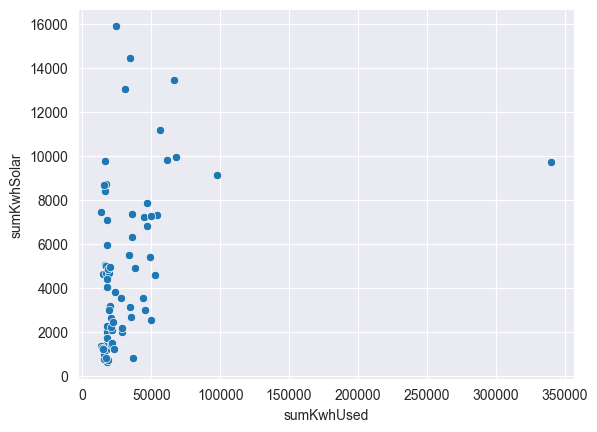

In [28]:
df = pd.read_sql_query("SELECT a.sumKwh as sumKwhUsed, a.bfsID, a.lawCityName, o.sumTotalPower as sumKwhSolar FROM (SELECT SUM(valueKwh / anzMeter) AS sumKwh, bfsID, lawCityName FROM smartmeter s JOIN plzBfsMapping m ON s.plz = m.plz GROUP BY bfsID) a JOIN solarPlantsLUbfsId o ON a.bfsID = o.bfsID;", connection)

sns.scatterplot(x='sumKwhUsed', y='sumKwhSolar', data=df)
plt.show()

## Datenanalyse mit Meteodaten und Smartmeterdaten
In diesem Notebook geht es darum kombinierte Analysen auszuführen. Also wie stehen die Smartmeter Daten im Verhältnis zu Meteodaten.

### Datenanalyse Smartmeter und Sonnendaten
Zuerst werden die Daten aus der Datenbank geladen und gleich im korrekten Zeitformat gesichert. Aus der ersten Analyse ist bekannt, dass es 4 Meteostationen gibt, welche die Sonnenminuten gemessen haben. Von diesen haben zwei (MOA und LUZ) den gesamten Zeitraum zu Verfügung. Dies wird nochmals in der Grafik ersichtlich. Es ist auch erkennbar, dass eine Saisonalität (Sommer/Winter) vorhanden ist. Im Winter gibt es erkennbar weniger Sonnenminuten wie im Sommer.

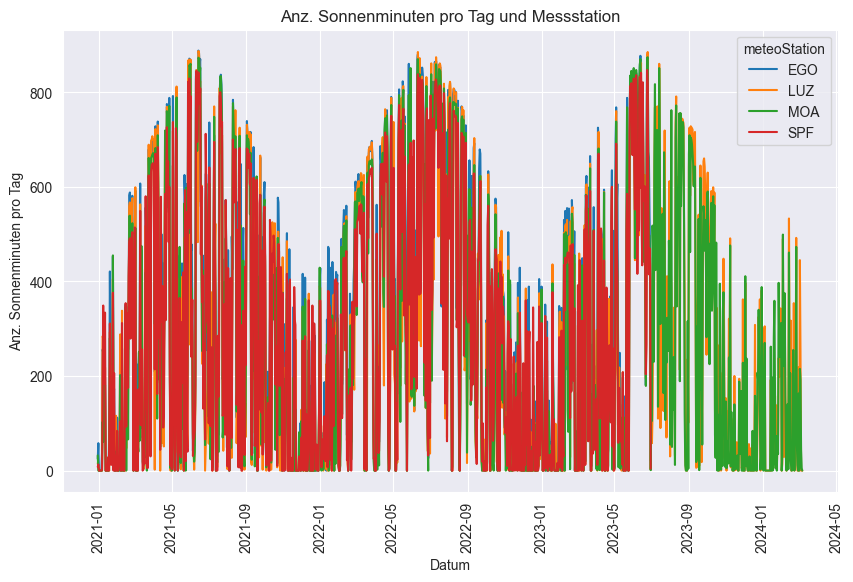

In [13]:
df_sun = pd.read_sql_query("SELECT SUM(meteoData.value) as 'sunMinDay', meteoData.dataTime, meteoData.meteoParameter, meteoStation FROM  meteoData WHERE meteoParameter == 'sre000h0' GROUP BY meteoStation, strftime('%Y-%m-%d', meteoData.dataTime)", connection)
df_sun['dataTime'] = pd.to_datetime(df_sun['dataTime'], format='%Y-%m-%d %H:%M')

plt.figure(figsize=(10, 6))
testPlot = sns.lineplot(x='dataTime', y='sunMinDay', hue='meteoStation', data=df_sun).set(title='Anz. Sonnenminuten pro Tag und Messstation', xlabel='Datum', ylabel='Anz. Sonnenminuten')
plt.xticks(rotation=90)
plt.show()

Als nächstes werden die Sonnenminuten und Zählerdaten pro BFS-Nummer geladen. Bei den Zählerdaten handelt es sich immer um den Durchschnittsverbrauch pro Gemeinde pro Zähler. Damit sind die Gemeinden untereinander vergleichbar. Mit der BFS-Nummer und dem Datum lassen sich die Daten verknüpfen.

In [14]:
df_sun = pd.read_sql_query("SELECT * FROM sumSunMinutesPerDayBfsId", connection)
df_sun.head()

,avgKwhConsum,time,bfsID,lawCityName
0,1.695778,2020-12-31,1001,Doppleschwand
1,21.895927,2021-01-01,1001,Doppleschwand
2,22.447296,2021-01-02,1001,Doppleschwand
3,22.783563,2021-01-03,1001,Doppleschwand
4,23.926130,2021-01-04,1001,Doppleschwand


In [15]:
df_power = pd.read_sql_query("SELECT * FROM dailySumSmartmeterBfsId", connection)
df_power.head()

,avgKwhConsum,time,bfsID,lawCityName
0,1.695778,2020-12-31,1001,Doppleschwand
1,21.895927,2021-01-01,1001,Doppleschwand
2,22.447296,2021-01-02,1001,Doppleschwand
3,22.783563,2021-01-03,1001,Doppleschwand
4,23.926130,2021-01-04,1001,Doppleschwand


In [16]:
df_sunPower = pd.merge(df_sun, df_power, on=['time', 'bfsID'])
df_sunPower['time'] = pd.to_datetime(df_sunPower['time'], format='%Y-%m-%d')
df_sunPower.head()

,sumSunDay,time,meteoParameter,bfsID,meteoStation,avgKwhConsum,lawCityName
0,13.0,2020-12-31,sre000h0,1001,SPF,1.695778,Doppleschwand
1,0.0,2021-01-01,sre000h0,1001,SPF,21.895927,Doppleschwand
2,0.0,2021-01-02,sre000h0,1001,SPF,22.447296,Doppleschwand
3,0.0,2021-01-03,sre000h0,1001,SPF,22.783563,Doppleschwand
4,0.0,2021-01-04,sre000h0,1001,SPF,23.926130,Doppleschwand


### Erstanalyse am Beispiel der Gemeinde Meggen
Bevor eine Analyse über sämtliche Daten durchgeführt wird, wird die Gemeinde Meggen als Beispiel genommen.

In [17]:
df_sunPowerMeggen = df_sunPower.query("bfsID == 1063").copy()
df_sunPowerMeggen.head()

,sumSunDay,time,meteoParameter,bfsID,meteoStation,avgKwhConsum,lawCityName
32840,9.0,2020-12-31,sre000h0,1063,LUZ,1.960185,Meggen
32841,0.0,2021-01-01,sre000h0,1063,LUZ,21.280028,Meggen
32842,0.0,2021-01-02,sre000h0,1063,LUZ,22.015781,Meggen
32843,0.0,2021-01-03,sre000h0,1063,LUZ,22.704968,Meggen
32844,0.0,2021-01-04,sre000h0,1063,LUZ,23.950467,Meggen


Auf der linken y-Achse wird der Verbrauch dargestellt und rechts die Sonnenminute. Bei der Betrachtung des Stromverbrauches erkennt man ebenfalls eine Saisonalität. Im Winter steigt der durchschnittliche Stromverbrauch und im Sommer nimmt dieser ab. Im Gegensatz zu der Sonne, welche zeitweise den Boden nicht erreicht (min = 0), wird permanent Strom verbraucht und ist nie 0.

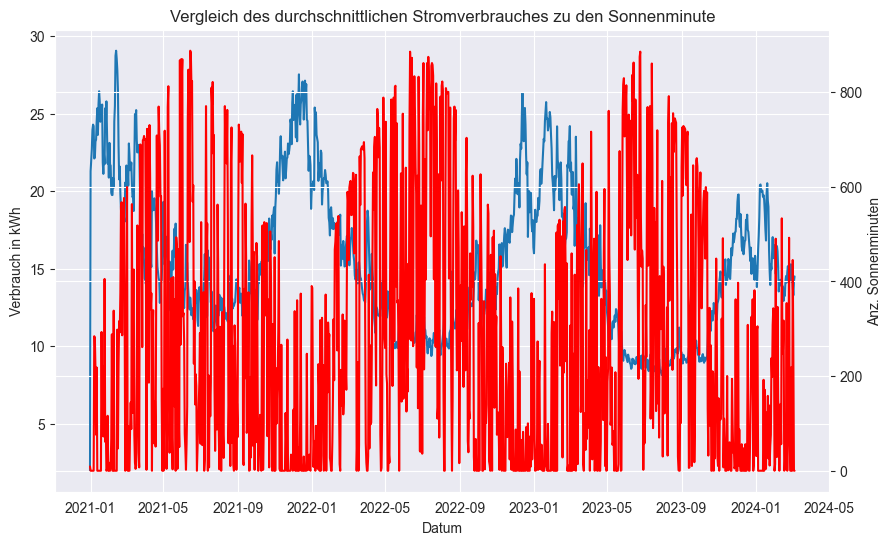

In [20]:
meggenPlot, ax1 = plt.subplots(figsize=(10, 6))
sns.lineplot(x='time', y='avgKwhConsum', data=df_sunPowerMeggen, ax=ax1).set(title='Vergleich des durchschnittlichen Stromverbrauches zu den Sonnenminute', xlabel='Datum', ylabel='Verbrauch in kWh')
ax2 = ax1.twinx()
sns.lineplot(data=df_sunPowerMeggen, x='time', y='sumSunDay', ax=ax2, color='red').set(ylabel='Anz. Sonnenminuten')
plt.xticks(rotation=90)
plt.show()

Als nächstes wird die Korrelation in Meggen betrachtet. Dazu werden alle nicht relevanten Spalten entfernt. Die Zeit-Spalte wird als Index verwendet. Mit einer Korrelation von -0.51 wird ein schwacher negativer Zusammenhang zwischen den Sonnenminuten und des Stromverbrauches bestätigt. Das bedeutet, je mehr Sonnenschein, desto tiefer der Stromverbrauch. Mehr Sonnenschein bedeuetet normalerweise auch höhere Temperaturen. Diese Analyse folgt in einem späteren Kapitel.<br>
Die Autocorrelation gibt anhand verschiedener Intervall an, wie stark die Werte von vorhergehenden Punkten in derselben Zeitreihe beeinflusst werden. Bei den Sonnenminuten gibt es keine regelmässigkeiten. Beim Strom sieht es anders aus. Mit jedem erweitern des Intervalls nimmt die Korrelation ab. Besonders bei 90-Tagen. Bei einem 1-Jahres Intervall ist die Korrelation wieder hoch. So kann zumindest angenommen werden, dass beim Strom eine wöchentliche und jährliche Korrelation besteht.


In [21]:
df_meggen = df_sunPowerMeggen.copy()
df_meggen.drop(columns=['meteoParameter', 'meteoStation', 'bfsID', 'lawCityName'], inplace=True)
df_meggen['time'] = pd.to_datetime(df_meggen['time'])
df_meggen.dropna(inplace=True)

#df_test = df_test.astype({'time': str})
df_meggen.index = df_meggen['time']
#df_test = df_test.astype({'sumSunDay': str})
df_meggen.drop(columns=['time'], inplace=True)
df_meggen.head()

,sumSunDay,avgKwhConsum
time,,
2020-12-31,9.0,1.960185
2021-01-01,0.0,21.280028
2021-01-02,0.0,22.015781
2021-01-03,0.0,22.704968
2021-01-04,0.0,23.950467


In [22]:
print('Korrelation zwischen den Parametern:\n', df_meggen.corr())
print('\nAutocorrelation der täglichen Sonnenminuten und Stromverbrauch:')
autocorrOneSun = df_meggen['sumSunDay'].autocorr(lag=1)
print('Sonne 1-Tages-Intervall:\t', autocorrOneSun)
autocorrOneKwh = df_meggen['avgKwhConsum'].autocorr(lag=1)
print('Strom 1-Tages-Intervall:\t', autocorrOneKwh)
autocorr7Sun = df_meggen['sumSunDay'].autocorr(lag=7)
print('Sonne 7-Tages-Intervall:\t', autocorr7Sun)
autocorr7Kwh = df_meggen['avgKwhConsum'].autocorr(lag=7)
print('Strom 7-Tages-Intervall:\t', autocorr7Kwh)
autocorr30Sun = df_meggen['sumSunDay'].autocorr(lag=30)
print('Sonne 30-Tages-Intervall:\t', autocorr30Sun)
autocorr30Kwh = df_meggen['avgKwhConsum'].autocorr(lag=30)
print('Strom 30-Tages-Intervall:\t', autocorr30Kwh)

autocorr90Sun = df_meggen['sumSunDay'].autocorr(lag=90)
print('Sonne 90-Tages-Intervall:\t', autocorr90Sun)
autocorr90Kwh = df_meggen['avgKwhConsum'].autocorr(lag=90)
print('Strom 90-Tages-Intervall:\t', autocorr90Kwh)

autocorr365Sun = df_meggen['sumSunDay'].autocorr(lag=365)
print('Sonne 365-Tages-Intervall:\t', autocorr365Sun)
autocorr365Kwh = df_meggen['avgKwhConsum'].autocorr(lag=365)
print('Strom 365-Tages-Intervall:\t', autocorr365Kwh)

Korrelation zwischen den Parametern:
               sumSunDay  avgKwhConsum
sumSunDay      1.000000     -0.507007
avgKwhConsum  -0.507007      1.000000

Autocorrelation der täglichen Sonnenminuten und Stromverbrauch:
Sonne 1-Tages-Intervall:	 0.5856540940738135
Strom 1-Tages-Intervall:	 0.9652398084847673
Sonne 7-Tages-Intervall:	 0.24205923351518965
Strom 7-Tages-Intervall:	 0.876914938831469
Sonne 30-Tages-Intervall:	 0.2126107296767323
Strom 30-Tages-Intervall:	 0.7425813064894666
Sonne 90-Tages-Intervall:	 -0.006841923670184412
Strom 90-Tages-Intervall:	 0.051753578484432475
Sonne 365-Tages-Intervall:	 0.2289604186064135
Strom 365-Tages-Intervall:	 0.7360299713821324


### Ausweitung der Analyse auf alle Gemeinden
Im nächsten Schritt wird die Korrelation-Analyse auf die weiteren Gemeinden ausgeweitet. Dazu wird die Analyse in West und Ost unterteilt, dies aufgrund der geografischen Standorte der Messstationen. Bei den westlichen Gemeinde werden die Daten bis zum 30.6.2024 verwendet.

In [23]:
df_west = df_sunPower.query("meteoStation == 'SPF' | meteoStation == 'EGO'")
df_east = df_sunPower.query("meteoStation == 'LUZ' | meteoStation == 'MOA'")
df_west.info()
df_east.info()
df_west = df_west.copy()
df_west.head()
df_east = df_east.copy()
df_east.head()
df_west.drop(columns=['meteoParameter', 'meteoStation', 'lawCityName'], inplace=True)
df_west['time'] = pd.to_datetime(df_west['time'])
df_west.dropna(inplace=True)
df_westPivot = df_west.pivot(index='time', columns=['bfsID'], values=['avgKwhConsum', 'sumSunDay'])
df_westPivot.info()

df_east.drop(columns=['meteoParameter', 'meteoStation', 'lawCityName'], inplace=True)
df_east['time'] = pd.to_datetime(df_east['time'])
df_east.dropna(inplace=True)
df_eastPivot = df_east.pivot(index='time', columns='bfsID', values=['avgKwhConsum', 'sumSunDay'])
df_eastPivot.info()

<class 'pandas.core.frame.DataFrame'>
Index: 36449 entries, 0 to 74734
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   sumSunDay       36449 non-null  float64       
 1   time            36449 non-null  datetime64[ns]
 2   meteoParameter  36449 non-null  object        
 3   bfsID           36449 non-null  int64         
 4   meteoStation    36449 non-null  object        
 5   avgKwhConsum    36449 non-null  float64       
 6   lawCityName     36449 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(1), object(3)
memory usage: 2.2+ MB
<class 'pandas.core.frame.DataFrame'>
Index: 38286 entries, 7296 to 54701
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   sumSunDay       38223 non-null  float64       
 1   time            38286 non-null  datetime64[ns]
 2   meteoParameter  38286 non-nul

Für eine bessere optische Ansicht wird mit den Korrelation-Werten eine Heatmap erstellt. Zuerst für die östliche Seite. Was sofort auffällt sind die beiden dunklen Vierecke. Unten rechts sind die Korrelationen zwischen den Sonnenminuten zwischen den Gemeinden. Diese Werte sind sehr hoch. Somit scheint die Sonne vielerorts gleichzeitig und unterscheidet sich im Schnitt pro Tag nicht sehr stark. Oben links befinden sich die Korrelationen zwischen den Gemeinden und des Stromverbrauchs. Vielfach verhaltet sich der Stromverbrauch ähnlich zu den Gemeinden. Es gibt aber einige Ausreisser. Dies kann mit den aussergewöhnlichen Anomalien Zusammenhängen, welche bei einigen Ortschaften in der ersten Analyse erkannt wurden. Dies ist z.B. bei der Gemeinde Kriens (plz=6010/BFS-Nummer=1059). Die verbleibenden Quadranten geben die Korrelation zwischen dem Stromverbrauch und den Sonnenminuten an. Was sich bei Meggen angedeutet hat lässt sich mit der Heatmap bestätigen. Die Korrelation liegt im Bereich von ca. -0.5. Ausser bei denen, welche bereits eine schwache Korrelation bei den Zählerdaten vorweisen. Dort geht die Korrelation noch weiter zurück bis gegen 0.

Korrelation zwischen den Parametern:
                    avgKwhConsum                                          \
bfsID                      1021      1023      1024      1025      1026   
             bfsID                                                        
avgKwhConsum 1021      1.000000  0.898951  0.893088  0.873645  0.900830   
             1023      0.898951  1.000000  0.780833  0.691224  0.784703   
             1024      0.893088  0.780833  1.000000  0.912564  0.957168   
             1025      0.873645  0.691224  0.912564  1.000000  0.940711   
             1026      0.900830  0.784703  0.957168  0.940711  1.000000   
...                         ...       ...       ...       ...       ...   
sumSunDay    1093     -0.402980 -0.312670 -0.450382 -0.470708 -0.470462   
             1097     -0.425425 -0.329409 -0.466936 -0.492010 -0.487830   
             1098     -0.402980 -0.312670 -0.450382 -0.470708 -0.470462   
             1100     -0.426356 -0.323347 -0.459410 -0.485422 

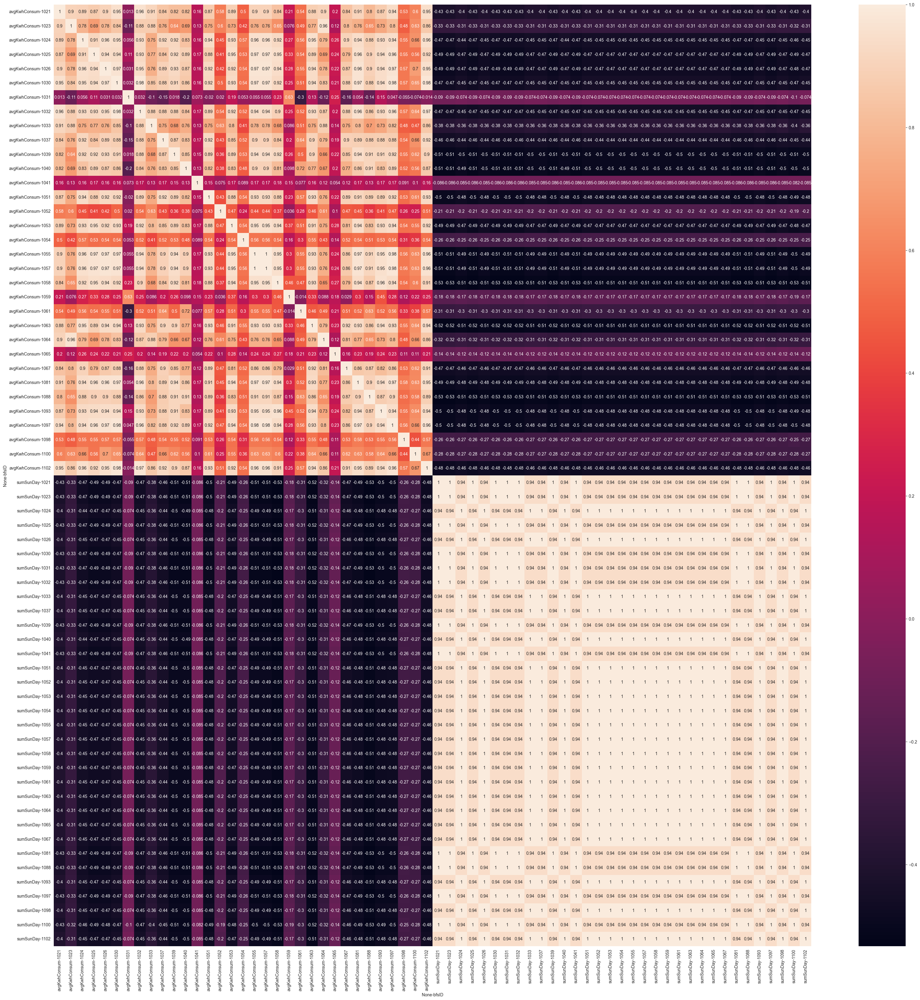

In [24]:
print('Korrelation zwischen den Parametern:\n', df_eastPivot.corr())

fig = plt.figure(figsize=(40, 40))
sns.heatmap(df_eastPivot.corr(), annot=True)
plt.show()

Die westliche Seite präsentiert sich in einem ähnlichen Gewand.

Korrelation zwischen den Parametern:
                    avgKwhConsum                                          \
bfsID                      1021      1023      1024      1025      1026   
             bfsID                                                        
avgKwhConsum 1021      1.000000  0.898951  0.893088  0.873645  0.900830   
             1023      0.898951  1.000000  0.780833  0.691224  0.784703   
             1024      0.893088  0.780833  1.000000  0.912564  0.957168   
             1025      0.873645  0.691224  0.912564  1.000000  0.940711   
             1026      0.900830  0.784703  0.957168  0.940711  1.000000   
...                         ...       ...       ...       ...       ...   
sumSunDay    1093     -0.402980 -0.312670 -0.450382 -0.470708 -0.470462   
             1097     -0.425425 -0.329409 -0.466936 -0.492010 -0.487830   
             1098     -0.402980 -0.312670 -0.450382 -0.470708 -0.470462   
             1100     -0.426356 -0.323347 -0.459410 -0.485422 

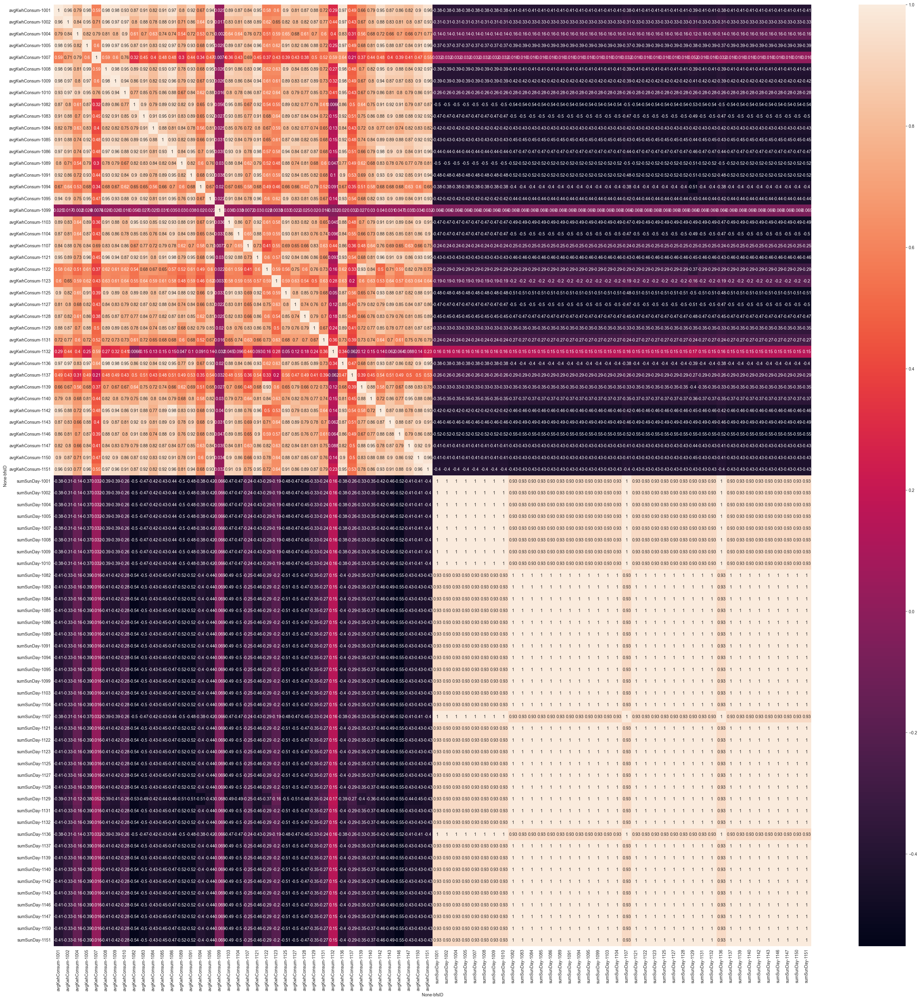

In [26]:
print('Korrelation zwischen den Parametern:\n', df_eastPivot.corr())

fig = plt.figure(figsize=(40, 40))
sns.heatmap(df_westPivot.corr(), annot=True)
plt.show()

Um die Korrelationen innerhalb der Zeitreihe noch besser einschätzen zu können, wird ein Boxplot erstellt.

In [31]:
columns = list(df_westPivot)
columns = list(df_eastPivot)

autocorrOneDay = []

#1 Day Correlation
for column in df_westPivot:
    autocorrOneSun = df_westPivot[column].autocorr(lag=1)
    col1 = column[0]+ 'OneDay'
    autocorrOneDay.append([col1,column[1],autocorrOneSun])

for column in df_eastPivot:
    autocorrOneSun = df_eastPivot[column].autocorr(lag=1)
    col1 = column[0]+ 'OneDay'
    autocorrOneDay.append([col1,column[1],autocorrOneSun])
#7 Day Correlation
for column in df_westPivot:
    autocorrOneSun = df_westPivot[column].autocorr(lag=7)
    col7 = column[0]+ '7Day'
    autocorrOneDay.append([col7,column[1],autocorrOneSun])

for column in df_eastPivot:
    autocorrOneSun = df_eastPivot[column].autocorr(lag=7)
    col7 = column[0]+ '7Day'
    autocorrOneDay.append([col7,column[1],autocorrOneSun])

#30 Day Correlation
for column in df_westPivot:
    autocorrOneSun = df_westPivot[column].autocorr(lag=30)
    col30 = column[0]+ '30Day'
    autocorrOneDay.append([col30,column[1],autocorrOneSun])

for column in df_eastPivot:
    autocorrOneSun = df_eastPivot[column].autocorr(lag=30)
    col30 = column[0]+ '30Day'
    autocorrOneDay.append([col30,column[1],autocorrOneSun])

for column in df_westPivot:
    autocorrOneSun = df_westPivot[column].autocorr(lag=90)
    col90 = column[0]+ '90Day'
    autocorrOneDay.append([col90,column[1],autocorrOneSun])

for column in df_eastPivot:
    autocorrOneSun = df_eastPivot[column].autocorr(lag=90)
    col90 = column[0]+ '90Day'
    autocorrOneDay.append([col90,column[1],autocorrOneSun])

for column in df_westPivot:
    autocorrOneSun = df_westPivot[column].autocorr(lag=365)
    col365 = column[0]+ '365Day'
    autocorrOneDay.append([col365,column[1],autocorrOneSun])

for column in df_eastPivot:
    autocorrOneSun = df_eastPivot[column].autocorr(lag=365)
    col365 = column[0]+ '365Day'
    autocorrOneDay.append([col365,column[1],autocorrOneSun])

df = pd.DataFrame(autocorrOneDay)
df = df.pivot(index=1, columns=0, values=2)
df.head()

,avgKwhConsum30Day,avgKwhConsum365Day,avgKwhConsum7Day,avgKwhConsum90Day,avgKwhConsumOneDay,sumSunDay30Day,sumSunDay365Day,sumSunDay7Day,sumSunDay90Day,sumSunDayOneDay
1,,,,,,,,,,
1001,0.667101,0.779139,0.810216,-0.004348,0.951492,0.18459,0.158684,0.273196,0.016199,0.593869
1002,0.606966,0.680825,0.752144,0.032680,0.937982,0.18459,0.158684,0.273196,0.016199,0.593869
1004,0.515631,0.579207,0.739573,0.000183,0.915557,0.18459,0.158684,0.273196,0.016199,0.593869
1005,0.703554,0.827965,0.837596,-0.003933,0.962068,0.18459,0.158684,0.273196,0.016199,0.593869
1007,0.162847,0.417719,0.375962,-0.058252,0.905284,0.18459,0.158684,0.273196,0.016199,0.593869


Im Boxplot setzt sich die Erkenntnis von Meggen weiter. Das 90-Tag Intervall ist nicht relevant. Während die sonst gewählten Intervall eine höhere Korrelation vorweisen. So korreliert der Stromverbrauch bei 50% der Gemeinden mit dem Wert von 0.74 zum vor jährlichen Tagesschnitt. Im Bereich der Sonnenminuten gibt es keine bedeutende Korrelation.

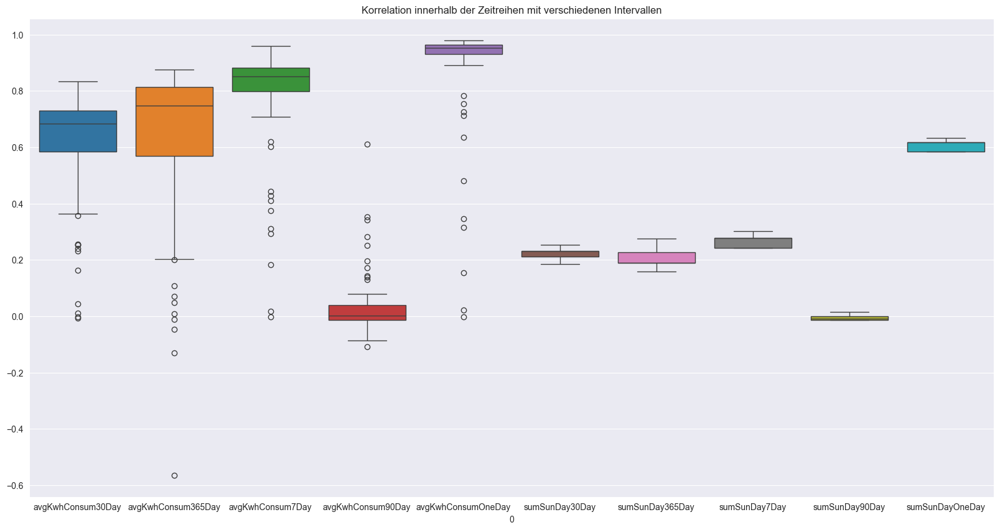

,avgKwhConsum30Day,avgKwhConsum365Day,avgKwhConsum7Day,avgKwhConsum90Day,avgKwhConsumOneDay,sumSunDay30Day,sumSunDay365Day,sumSunDay7Day,sumSunDay90Day,sumSunDayOneDay
count,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000,73.000000
mean,0.600190,0.612668,0.773878,0.037146,0.876102,0.222840,0.210259,0.270627,-0.005504,0.607303
std,0.207985,0.298853,0.206700,0.109700,0.213492,0.020680,0.037105,0.020081,0.009887,0.017619
min,-0.006656,-0.564144,-0.001339,-0.107675,-0.001111,0.184590,0.158684,0.242767,-0.014136,0.585645
25%,0.584245,0.569482,0.798387,-0.014000,0.930055,0.211331,0.188957,0.242767,-0.014136,0.585645
50%,0.682995,0.747192,0.850890,0.003099,0.953881,0.231780,0.188957,0.277336,-0.009245,0.616811
75%,0.731128,0.813872,0.882041,0.038919,0.964393,0.231780,0.228291,0.277336,-0.000374,0.616811
max,0.833385,0.876844,0.960116,0.610207,0.980163,0.253675,0.276120,0.301913,0.016199,0.633528


In [33]:
fig = plt.figure(figsize=(20, 10))
sns.boxplot(df).set(title='Korrelation innerhalb der Zeitreihen mit verschiedenen Intervallen')
plt.show()
df.describe()

Für den Boxplot der Korrelationen zwischen den Parametern werden normale Korrelationsmatrixen erstellt und die nicht notwendigen Index und Spalten entfernt.

In [43]:
df_corrWest = df_westPivot[['avgKwhConsum', 'sumSunDay']].corr()
df_corrWest.drop(columns=['sumSunDay'], index=['avgKwhConsum'],inplace=True)
df_corrEast = df_eastPivot[['avgKwhConsum', 'sumSunDay']].corr()
df_corrEast.drop(columns=['sumSunDay'], index=['avgKwhConsum'],inplace=True)

Der Boxplot für den westlichen Teil zeigt das 75% der Korrelationswerte tiefer als ca. -0.3 sind, also eine stärkere Korrelation aufweisen. Wobei nur 25% der Korrelation zwischen ca. -0.475 und ca. -0.55 liegen. Der östliche Teil hat weniger Outlier und das 75% Quantil ein wenig früher bei ca. -0.29 startet. Generll gibt somit keine starke Verbindung zwischen diesen zwei Parametern.

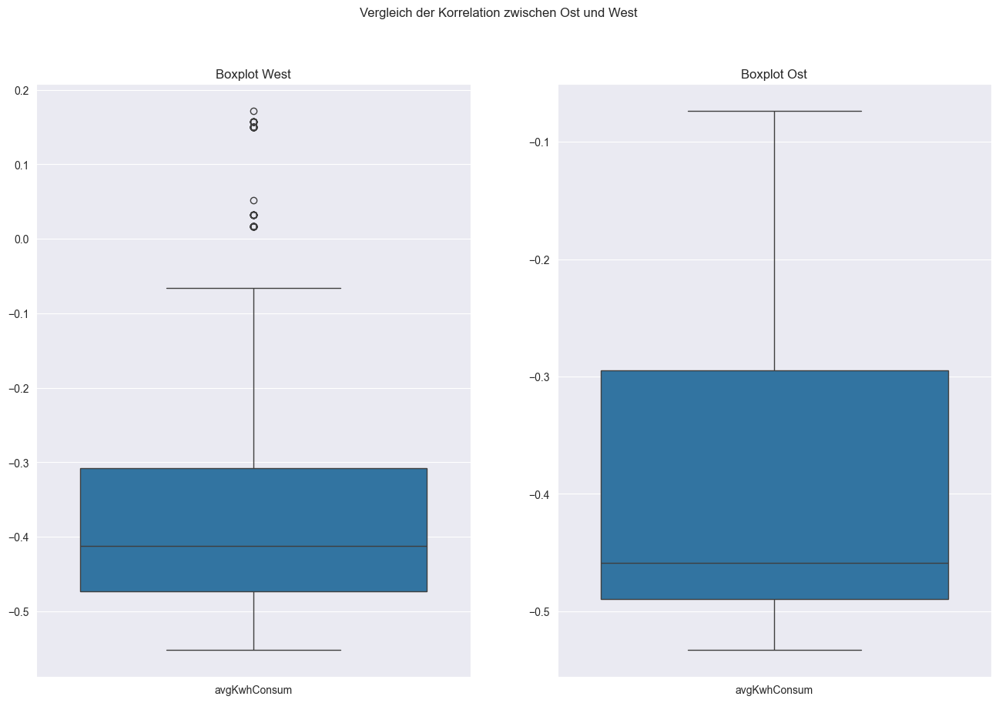

avgKwhConsum                                                         \
bfsID         1021       1023       1024       1025       1026       1030   
count    33.000000  33.000000  33.000000  33.000000  33.000000  33.000000   
mean     -0.411170  -0.318573  -0.455672  -0.478254  -0.476571  -0.454365   
std       0.011004   0.007997   0.008496   0.010199   0.008288   0.010162   
min      -0.426356  -0.329409  -0.466936  -0.492010  -0.487830  -0.467785   
25%      -0.425425  -0.329409  -0.466936  -0.492010  -0.487830  -0.467785   
50%      -0.402980  -0.312670  -0.450382  -0.470708  -0.470462  -0.446806   
75%      -0.402980  -0.312670  -0.450382  -0.470708  -0.470462  -0.446806   
max      -0.402980  -0.312670  -0.442102  -0.470708  -0.470462  -0.446806   

                                                   ...                        \
bfsID       1031       1032       1033       1037  ...       1064       1065   
count  33.000000  33.000000  33.000000  33.000000  ...  33.000000  33.000000   
mean   -0.079883  -0.456225  -0.368016  -0.446138  ...  -0.315823  -0.127799   
std     0.008379   0.007948   0.010754   0.007242  ...   0.006250   0.008993   
min    -0.100209  -0.467428  -0.395939  -0.456065  ...  -0.324449  -0.139632   
25%    -0.089670  -0.466499  -0.380289  -0.456065  ...  -0.324449  -0.139632   
50%    -0.073788  -0.450310  -0.360258  -0.440838  ...  -0.311290  -0.121107   
75%    -0.073788  -0.450310  -0.360258  -0.440838  ...  -0.311290  -0.121107   
max    -0.073788  -0.450310  -0.360258  -0.440838  ...  -0.311290  -0.121107   

                                                                         \
bfsID       1067       1081       1088       1093       1097       1098   
count  33.000000  33.000000  33.000000  33.000000  33.000000  33.000000   
mean   -0.461798  -0.482191  -0.520989  -0.486852  -0.485279  -0.264589   
std     0.004266   0.007824   0.008951   0.008968   0.010417   0.004734   
min    -0.467714  -0.492862  -0.533121  -0.498999  -0.499081  -0.267655   
25%    -0.467714  -0.492862  -0.533121  -0.498999  -0.499081  -0.267655   
50%    -0.458738  -0.476440  -0.514382  -0.480230  -0.477534  -0.267655   
75%    -0.458738  -0.476440  -0.514382  -0.480230  -0.477534  -0.260372   
max    -0.458738  -0.476440  -0.514382  -0.480230  -0.477534  -0.246586   

                             
bfsID       1100       1102  
count  33.000000  33.000000  
mean   -0.274259  -0.470380  
std     0.001068   0.008843  
min    -0.275650  -0.482058  
25%    -0.275650  -0.482058  
50%    -0.273464  -0.463802  
75%    -0.273464  -0.463802  
max    -0.273464  -0.463802  

[8 rows x 33 columns]

In [44]:
fig, axes = plt.subplots(1, 2, figsize=(16,10))
fig.suptitle('Vergleich der Korrelation zwischen Ost und West')
sns.boxplot(ax = axes[0], data=df_corrWest).set(title='Boxplot West')
sns.boxplot(ax = axes[1], data=df_corrEast).set(title='Boxplot Ost')
plt.show()
df_corrWest.describe()
df_corrEast.describe()

Abschliessend kann gesagt werden, dass die Sonne wohl keinen direkten Einfluss auf den Stromverbrauch hat. 

## Mögliche Analyse Solarpanels, Stromverbrauch während Sonnenzeit und während Sonne weg ist



## Datenanalyse Smartmeter mit Regendaten
Als nächster Schritt in der Analyse werden die Regendaten verwendet. 

AttributeError: 'list' object has no attribute 'set_legend'

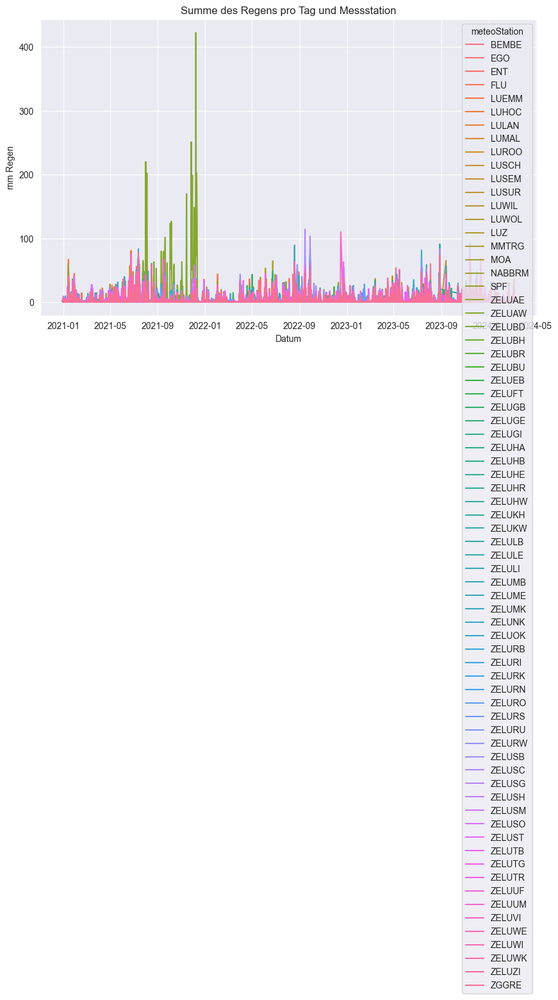

In [9]:
df_rain = pd.read_sql_query("SELECT SUM(meteoData.value) as 'rainDay', meteoData.dataTime, meteoData.meteoParameter, meteoStation FROM  meteoData WHERE meteoParameter == 'rre150h0' GROUP BY meteoStation, strftime('%Y-%m-%d', meteoData.dataTime)", connection)
df_rain['dataTime'] = pd.to_datetime(df_rain['dataTime'], format='%Y-%m-%d %H:%M')

plt.figure(figsize=(10, 6))
testPlot = sns.lineplot(x='dataTime', y='rainDay', hue='meteoStation', data=df_rain).set(title='Summe des Regens pro Tag und Messstation', xlabel='Datum', ylabel='mm Regen')
plt.xticks(rotation=90)
plt.show()